In [1]:
from Loader_17 import DAVIS_Rawset, normalize
from deform_video import DAVIS_withPoint, IMGPositionEmbeddingSine, PositionalEncoding, get_valid_ratio, MLP
from deform_model import DeformableTransformerDecoderLayer, DeformableTransformerDecoder, get_batch_average_bou_iou
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
import torch
from torch import nn
from torch.optim import Adam
from einops import rearrange, repeat, reduce
import numpy as np
import torch.nn.functional as F
import gc
from polygon import SoftPolygon, RasLoss
import random
from tqdm import tqdm
from cotracker import Cotracker, VideoLoss

In [2]:
!nvidia-smi

Wed Nov 27 13:52:44 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 565.57.01              Driver Version: 565.57.01      CUDA Version: 12.7     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla V100-SXM2-32GB           On  |   00000000:15:00.0 Off |                    0 |
| N/A   33C    P0             57W /  300W |    2098MiB /  32768MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [3]:
val_raw_set = DAVIS_Rawset(is_train=False)

In [ ]:
train_raw_set = DAVIS_Rawset(is_train=True)

In [ ]:
# class Cotracker(nn.Module):
#     def __init__(
#         self,
#         point_num: int,
#         refine_iter: int = 6,
#         freeze_featup: bool = True,
#         d_model: int = 256,
#         n_heads: int = 8,
#         n_points: int = 8,
#         d_ffn: int = 1024,
#     ):
#         super(Cotracker, self).__init__()
#         self.refine_iter = refine_iter
#         self.featup = torch.hub.load(
#             "mhamilton723/FeatUp",
#             "dino16",
#             use_norm=True,
#         )
#         if freeze_featup:
#             for param in self.featup.parameters():
#                 param.requires_grad = False
#         d_featup = 384
#         if d_featup != d_model:
#             self.featup_fc = nn.Linear(d_featup, d_model)
#         else:
#             self.featup_fc = nn.Identity()
#         self.medium_level_size = [14, 28, 56, 112]
#         n_levels = len(self.medium_level_size) + 1
#         n_layers = 1
#         self.offset_ratio = 0.2
#         self.pos_2d = IMGPositionEmbeddingSine(d_model)
#         self.pos_1d = PositionalEncoding(d_model)
#         self.level_pos = nn.Embedding(n_levels, d_model)
#         nn.init.xavier_uniform_(self.level_pos.weight)

#         self.query_embed = nn.Embedding(point_num, d_model)
#         nn.init.xavier_uniform_(self.query_embed.weight)
#         dec_layer = DeformableTransformerDecoderLayer(
#             d_model=d_model,
#             d_ffn=d_ffn,
#             n_levels=n_levels,
#             n_heads=n_heads,
#             n_points=n_points,
#         )
#         self.def_dec_layernorm = nn.LayerNorm(d_model)
#         self.def_decoder = DeformableTransformerDecoder(
#             decoder_layer=dec_layer,
#             num_layers=n_layers,
#         )
#         self.fir_layernorm = nn.LayerNorm(d_model)
#         self.fir_encoder = nn.TransformerEncoder(
#             encoder_layer=nn.TransformerEncoderLayer(
#                 d_model,
#                 n_heads,
#                 d_ffn,
#                 batch_first=True,
#             ),
#             num_layers=1,
#         )
#         self.other_layernorm = nn.LayerNorm(d_model)
#         self.other_decoder = nn.TransformerDecoder(
#             decoder_layer=nn.TransformerDecoderLayer(
#                 d_model,
#                 n_heads,
#                 d_ffn,
#                 batch_first=True,
#             ),
#             num_layers=1,
#         )
#         self.delta_xy_fc = MLP(d_model, d_model, 2, 3)
#         self.delta_query_fc = MLP(d_model, d_model, d_model, 3)

#     def forward(self, imgs: torch.Tensor, points: torch.Tensor):
#         batch_size, frame_num, _, img_h, img_w = imgs.shape
#         _, _, point_num, _ = points.shape

#         points = points / 224.0

#         fir_img = imgs[:, 0]
#         fir_points = points[:, 0]
#         (
#             fir_src_flatten,
#             fir_spatial_shapes,
#             fir_level_start_index,
#             fir_valid_ratios,
#             fir_pos_embed_flatten,
#         ) = self._get_img_scrs(fir_img, self.def_dec_layernorm)
#         fir_src_flatten += fir_pos_embed_flatten
#         fir_query_embed = repeat(self.query_embed.weight, "p d -> b p d", b=batch_size)
#         fir_point_feats, _ = self.def_decoder(
#             fir_query_embed,
#             fir_points,
#             fir_src_flatten,
#             fir_spatial_shapes,
#             fir_level_start_index,
#             fir_valid_ratios,
#         )
#         fir_point_feats = self.fir_layernorm(fir_point_feats)
#         fir_query = self.pos_1d(fir_point_feats)
#         fir_memory = self.fir_encoder(fir_query)

#         other_imgs = imgs[:, 1:]
#         other_points = points[:, 1:]
#         other_imgs = rearrange(other_imgs, "b f c h w -> (b f) c h w")
#         other_points = rearrange(other_points, "b f p d -> (b f) p d")
#         (
#             other_src_flatten,
#             other_spatial_shapes,
#             other_level_start_index,
#             other_valid_ratios,
#             other_pos_embed_flatten,
#         ) = self._get_img_scrs(other_imgs, self.def_dec_layernorm)
#         other_src_flatten += other_pos_embed_flatten
#         other_queries = repeat(
#             self.query_embed.weight, "p d -> b p d", b=batch_size * (frame_num - 1)
#         )

#         output_coords = []
#         for i in range(self.refine_iter):
#             other_point_feats, _ = self.def_decoder(
#                 other_queries,
#                 other_points,
#                 other_src_flatten,
#                 other_spatial_shapes,
#                 other_level_start_index,
#                 other_valid_ratios,
#             )
#             other_point_queries = rearrange(
#                 other_point_feats, "(b f)p d -> b (f p) d", f=frame_num - 1
#             )
#             other_point_queries = self.other_layernorm(other_point_queries)
#             other_point_queries = self.pos_1d(other_point_queries)
#             other_point_queries = self.other_decoder(
#                 tgt=other_point_queries,
#                 memory=fir_memory,
#             )
#             other_point_queries = rearrange(
#                 other_point_queries, "b (f p) d -> (b f) p d", f=frame_num - 1
#             )
#             delta_xy = self.delta_xy_fc(other_point_queries)
#             delta_xy = (delta_xy.sigmoid() - 0.5) * self.offset_ratio
#             other_points = other_points + delta_xy
#             result = rearrange(
#                 other_points, "(b f) p d -> b f p d", b=batch_size, f=frame_num - 1
#             )
#             result = result * 224.0
#             output_coords.append(result)
#             delta_query = self.delta_query_fc(other_point_feats)
#             other_queries = other_queries + delta_query
#         output_coords = torch.stack(output_coords, 1)
#         return output_coords

#     def _get_img_scrs(self, img: torch.Tensor, layernorm: nn.LayerNorm):
#         b, c, h, w = img.shape
#         feats = self.featup(img)
#         feats = rearrange(feats, "b c h w -> b (h w) c")
#         feats = self.featup_fc(feats)
#         feats = rearrange(feats, "b (h w) c -> b c h w", h=h, w=w)
#         srcs = []
#         padding_masks = []
#         pos_embeds = []
#         for low_res in self.medium_level_size:
#             srcs.append(
#                 F.interpolate(
#                     feats,
#                     size=(low_res, low_res),
#                     mode="bilinear",
#                 ),
#             )
#         srcs.append(feats)
#         for src in srcs:
#             padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
#             pos_embeds.append(self.pos_2d(src, padding_masks[-1]))
#         src_flatten = []
#         spatial_shapes = []
#         pos_embed_flatten = []

#         for lvl, (src, pos) in enumerate(zip(srcs, pos_embeds)):
#             src_flatten.append(
#                 rearrange(src, "b c h w -> b (h w) c"),
#             )
#             spatial_shapes.append(src.shape[-2:])
#             pos = rearrange(pos, "b c h w -> b (h w) c")
#             pos = self.level_pos.weight[lvl].view(1, 1, -1) + pos
#             pos_embed_flatten.append(pos)

#         level_start_index = torch.cat(
#             (
#                 torch.tensor([0]),
#                 torch.cumsum(
#                     torch.tensor([x.shape[1] for x in src_flatten]),
#                     0,
#                 )[:-1],
#             )
#         ).cuda()
#         src_flatten = torch.cat(src_flatten, 1).cuda()
#         pos_embed_flatten = torch.cat(pos_embed_flatten, 1).cuda()
#         valid_ratios = torch.stack(
#             [get_valid_ratio(mask) for mask in padding_masks],
#             1,
#         ).cuda()
#         spatial_shapes = torch.as_tensor(
#             spatial_shapes,
#             dtype=torch.long,
#             device=src_flatten.device,
#         )
#         src_flatten = layernorm(src_flatten)

#         return (
#             src_flatten,
#             spatial_shapes,
#             level_start_index,
#             valid_ratios,
#             pos_embed_flatten,
#         )

In [4]:
gt_rasterizer = SoftPolygon(1, "hard_mask").cuda()
ras_loss = RasLoss().cuda()

In [11]:
val_point_set = DAVIS_withPoint(val_raw_set, 32, is_train=False)

In [59]:
train_point_set = DAVIS_withPoint(train_raw_set, 32, is_train=True)

In [5]:
class DAVIS_Windows(Dataset):
    def __init__(
        self,
        raw_set: list[list[tuple[torch.Tensor, torch.Tensor]]],
        window_size: int,
    ):
        self.raw_set = raw_set
        self.window_size = window_size
    
    def __len__(self):
        return len(self.raw_set)
    
    def __getitem__(self, idx: int):
        video_data = self.raw_set[idx]
        video_len = len(video_data)
        start_min = 0
        start_max = video_len - self.window_size - 1
        if start_max < start_min:
            start_idx = 0
            window_size = video_len
        else:
            start_idx = random.randint(start_min, start_max)
            window_size = self.window_size
        img_list = []
        mask_list = []
        point_list = []
        for i in range(window_size):
            img, mask, point = video_data[start_idx + i]
            img_list.append(img)
            mask_list.append(mask)
            point_list.append(point)
        imgs = torch.stack(img_list, 0)
        masks = torch.stack(mask_list, 0)
        points = torch.stack(point_list, 0)
        return imgs, masks, points



In [10]:
val_video_set = DAVIS_Windows(val_point_set.raw_data_set[22:23], 40)
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=True)

torch.Size([1, 24, 3, 224, 224]) torch.Size([1, 24, 224, 224]) torch.Size([1, 24, 32, 2])
tensor(0.9514, device='cuda:0')


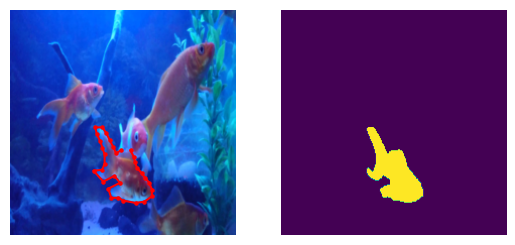

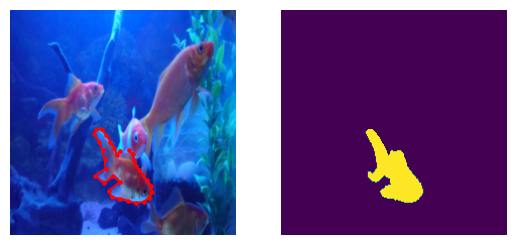

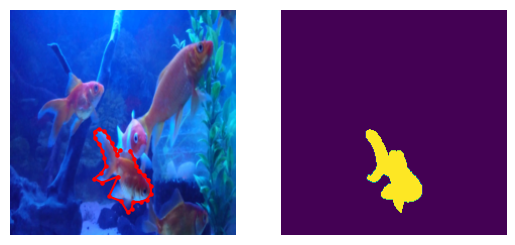

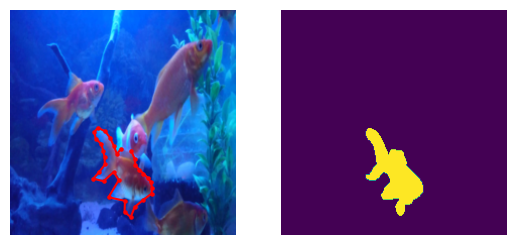

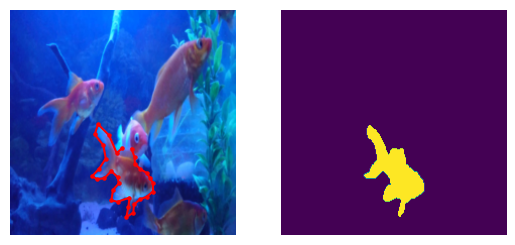

...

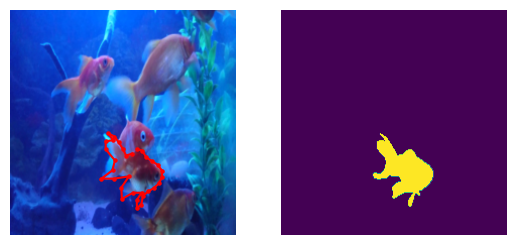

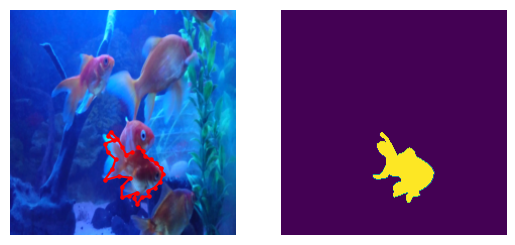

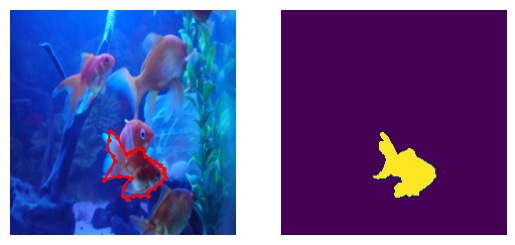

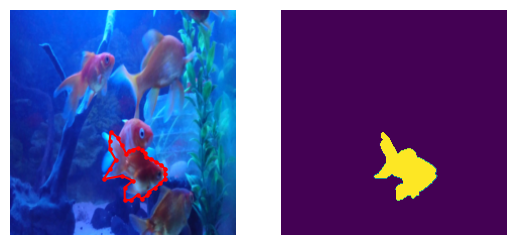

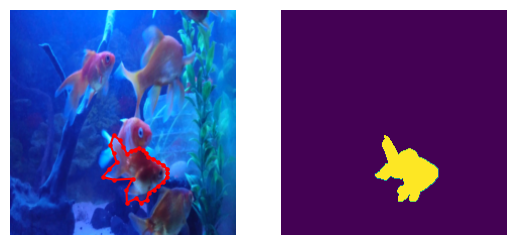

In [10]:
imgs, masks, points = next(iter(val_video_loader))
print(imgs.shape, masks.shape, points.shape)
print(
    get_batch_average_bou_iou(
        rearrange(points.cuda(), "b f p xy -> (b f) p xy"),
        rearrange(masks.cuda(), "b f h w -> (b f) h w"),
        gt_rasterizer,
    )
)
for i in range(len(imgs[0])):
    plt.subplot(1, 2 ,1)
    plt.axis("off")
    plt.imshow(normalize(imgs[0][i]).permute(1, 2, 0))
    plt.plot(points[0][i][:, 0], points[0][i][:, 1], c="r")
    plt.scatter(points[0][i][:, 0], points[0][i][:, 1], c="r", s=5)
    plt.subplot(1, 2, 2)
    plt.axis("off")
    plt.imshow(masks[0][i])
    plt.show()

In [11]:
imgs.shape, masks.shape, points.shape

(torch.Size([1, 24, 3, 224, 224]),
 torch.Size([1, 24, 224, 224]),
 torch.Size([1, 24, 32, 2]))

In [12]:
fir_point = points[:, 0]
fir_points = repeat(fir_point, "b p xy -> b f p xy", f=24)
fir_points.shape

torch.Size([1, 24, 32, 2])

In [111]:
# model = Cotracker(32).cuda()
# with torch.no_grad():
#     output_coords = model(imgs[:, :8].cuda(), points[:, :8].cuda())
# output_coords.shape

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


torch.Size([1, 6, 7, 32, 2])

In [100]:
gc.collect()
torch.cuda.empty_cache()

In [ ]:
# class VideoLoss(nn.Module):
#     def __init__(self, ras_loss: RasLoss, gt_rasterizer: SoftPolygon):
#         super(VideoLoss, self).__init__()
#         self.ras_loss = ras_loss
#         self.gt_rasterizer = gt_rasterizer

#     def forward(self, pred_points: torch.Tensor, gt_masks: torch.Tensor):
#         pred_points = rearrange(pred_points, "b i f p xy -> i (b f) p xy")
#         gt_masks = rearrange(gt_masks, "b f h w -> (b f) h w")
#         total_loss = 0
#         total_iou = 0
#         iter_num = pred_points.shape[0]
#         for i in range(iter_num):
#             pred_point = pred_points[i]
#             loss = self.ras_loss(pred_point, gt_masks)
#             total_loss += loss
#         total_loss /= iter_num
#         iou = get_batch_average_bou_iou(
#             pred_points[-1],
#             gt_masks,
#             self.gt_rasterizer,
#         )
#         return total_loss, iou

In [14]:
def check_allocate_mem():
    print(torch.cuda.memory_allocated() / 1024 / 1024 / 1024, "GB")


In [27]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [16]:
total_win_size = 40
small_win_size = 10
half_win_size = small_win_size // 2
sliding_win_num = (total_win_size - small_win_size) // half_win_size + 1
sliding_win_num, half_win_size

(7, 5)

In [21]:
tmp_raw_set = val_video_set.raw_set
tmp_video_set = DAVIS_Windows(tmp_raw_set, total_win_size)
tmp_video_loader = DataLoader(tmp_video_set, batch_size=1, shuffle=True)
video_loss = VideoLoss(ras_loss, gt_rasterizer)

In [25]:
len(tmp_raw_set[0])

78

In [22]:
loss_dict = {}
iou_dict = {}
epoch_num = 200

In [45]:
# for e in range(epoch_num):
#     total_loss = 0
#     total_iou = 0
#     for imgs, masks, points in tmp_video_loader:
#         optimizer.zero_grad()
#         fir_imgs = imgs[:, :small_win_size]
#         fir_masks = masks[:, :small_win_size]
#         fir_point = points[:, 0]
#         fir_points = repeat(fir_point, "b p xy -> b f p xy", f=small_win_size)
#         fir_imgs = fir_imgs.cuda()
#         fir_masks = fir_masks.cuda()
#         fir_points = fir_points.cuda()
#         fir_pred_points = model(fir_imgs, fir_points)
#         total_pred_points = fir_pred_points
#         for i in range(1, sliding_win_num):
#             cur_imgs = imgs[:, i * half_win_size : i * half_win_size + small_win_size]
#             cur_masks = masks[:, i * half_win_size : i * half_win_size + small_win_size]
#             new_points = repeat(
#                 total_pred_points[:, -1, -1], "b p xy -> b f p xy", f=half_win_size
#             )
#             old_points = total_pred_points[:, -1, -half_win_size:]
#             cur_points = torch.cat([old_points, new_points], 1)
#             cur_imgs = cur_imgs.cuda()
#             cur_masks = cur_masks.cuda()
#             cur_points = cur_points.cuda()
#             cur_pred_points = model(cur_imgs, cur_points)
#             new_pred_points = cur_pred_points[:, :, -half_win_size:]
#             total_pred_points = torch.cat([total_pred_points, new_pred_points], 2)
#         target_masks = masks[:, 1:]
#         loss, iou = video_loss(total_pred_points, target_masks.cuda())
#         loss.backward()
#         optimizer.step()
#         total_loss += loss.item()
#         total_iou += iou.item()
#         del fir_imgs, fir_masks, fir_points, fir_pred_points
#         del cur_imgs, cur_masks, cur_points, cur_pred_points
#         del new_points, old_points, new_pred_points
#         del total_pred_points
#         del loss, iou
#         gc.collect()
#         torch.cuda.empty_cache()
#     total_loss /= len(tmp_video_loader)
#     total_iou /= len(tmp_video_loader)
#     print(f"Epoch: {e}, Loss: {total_loss:.4f}, IoU: {total_iou:.4f}")

Epoch: 0, Loss: 0.4775, IoU: 0.3796
Epoch: 1, Loss: 0.3013, IoU: 0.5016
Epoch: 2, Loss: 0.5438, IoU: 0.2754
Epoch: 3, Loss: 0.4849, IoU: 0.2841
Epoch: 4, Loss: 0.2363, IoU: 0.6315
Epoch: 5, Loss: 0.3267, IoU: 0.5001
Epoch: 6, Loss: 0.3360, IoU: 0.4715
Epoch: 7, Loss: 0.3360, IoU: 0.4627
Epoch: 8, Loss: 0.1834, IoU: 0.6815
Epoch: 9, Loss: 0.3088, IoU: 0.4971
Epoch: 10, Loss: 0.2515, IoU: 0.5866
Epoch: 11, Loss: 0.2558, IoU: 0.5938
Epoch: 12, Loss: 0.3751, IoU: 0.4466
Epoch: 13, Loss: 0.2422, IoU: 0.6295
Epoch: 14, Loss: 0.1975, IoU: 0.6465
Epoch: 15, Loss: 0.2132, IoU: 0.6534
Epoch: 16, Loss: 0.2465, IoU: 0.5782
Epoch: 17, Loss: 0.2000, IoU: 0.6518
Epoch: 18, Loss: 0.1792, IoU: 0.6780
Epoch: 19, Loss: 0.2706, IoU: 0.5505
Epoch: 20, Loss: 0.1572, IoU: 0.7316
Epoch: 21, Loss: 0.1896, IoU: 0.6874
Epoch: 22, Loss: 0.1847, IoU: 0.6810
Epoch: 23, Loss: 0.2353, IoU: 0.6245
Epoch: 24, Loss: 0.2034, IoU: 0.6649
Epoch: 25, Loss: 0.2532, IoU: 0.5954
Epoch: 26, Loss: 0.2229, IoU: 0.6345
Epoch: 27, 

In [28]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for imgs, masks, points in tmp_video_loader:
        fir_point = points[:, 0]
        cur_points = repeat(fir_point, "b p xy -> b f p xy", f=small_win_size)
        loss = 0
        iou = 0
        for i in range(0, sliding_win_num):
            cur_imgs = imgs[
                :, i * half_win_size : i * half_win_size + small_win_size
            ]
            cur_masks = masks[
                :, i * half_win_size : i * half_win_size + small_win_size
            ]
            optimizer.zero_grad()
            cur_imgs = cur_imgs.cuda()
            cur_masks = cur_masks.cuda()
            cur_points = cur_points.cuda()
            cur_pred_points = model(cur_imgs, cur_points)
            target_masks = cur_masks[:, 1:]
            tmp_loss, tmp_iou = video_loss(cur_pred_points, target_masks)
            tmp_loss.backward()
            optimizer.step()
            loss += tmp_loss.item()
            iou += tmp_iou.item()
            new_points = repeat(
                cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=half_win_size
            ).detach()
            old_points = cur_pred_points[:, -1, -half_win_size:].detach()
            cur_points = torch.cat([old_points, new_points], 1)
        loss /= sliding_win_num
        iou /= sliding_win_num
        total_loss += loss
        total_iou += iou
    total_loss /= len(tmp_video_loader)
    total_iou /= len(tmp_video_loader)
    print(f"Epoch {e}, Loss: {loss:.4f}, IoU: {iou:.4f}")

Epoch 0, Loss: 0.6162, IoU: 0.2489
Epoch 1, Loss: 0.3636, IoU: 0.4309
Epoch 2, Loss: 0.6093, IoU: 0.2285
Epoch 3, Loss: 0.5278, IoU: 0.2913
Epoch 4, Loss: 0.5947, IoU: 0.2254
Epoch 5, Loss: 0.5820, IoU: 0.2650
Epoch 6, Loss: 0.2775, IoU: 0.5643
Epoch 7, Loss: 0.3156, IoU: 0.4919
Epoch 8, Loss: 0.3793, IoU: 0.4510
Epoch 9, Loss: 0.4228, IoU: 0.3783
Epoch 10, Loss: 0.3645, IoU: 0.4550
Epoch 11, Loss: 0.6625, IoU: 0.1820
Epoch 12, Loss: 0.2303, IoU: 0.6166
Epoch 13, Loss: 0.2827, IoU: 0.5546
Epoch 14, Loss: 0.4140, IoU: 0.4089
Epoch 15, Loss: 0.2809, IoU: 0.5446
Epoch 16, Loss: 0.2238, IoU: 0.6320
Epoch 17, Loss: 0.2261, IoU: 0.6352
Epoch 18, Loss: 0.2607, IoU: 0.5823
Epoch 19, Loss: 0.1932, IoU: 0.6770
Epoch 20, Loss: 0.2312, IoU: 0.6189
Epoch 21, Loss: 0.1897, IoU: 0.6776
Epoch 22, Loss: 0.2035, IoU: 0.6669
Epoch 23, Loss: 0.2253, IoU: 0.6198
Epoch 24, Loss: 0.1621, IoU: 0.7241
Epoch 25, Loss: 0.1584, IoU: 0.7280
Epoch 26, Loss: 0.1699, IoU: 0.7224
Epoch 27, Loss: 0.1663, IoU: 0.7057
Ep

In [15]:
class CoWinEvaler:
    def __init__(
        self,
        raw_set: list[list[tuple[torch.Tensor, torch.Tensor]]],
        gt_rasterizer: SoftPolygon,
        frame_num: int = 10,
    ) -> None:
        self.raw_set = raw_set
        self.gt_rasterizer = gt_rasterizer
        self.frame_num = frame_num
        self.total_pred_results = []

    def eval_one_video(self, video_idx: int, model: Cotracker):
        video_data = self.raw_set[video_idx]
        video_len = len(video_data)
        img_list = []
        mask_list = []
        point_list = []
        for frame_idx in range(video_len):
            img, mask, point = video_data[frame_idx]
            img_list.append(img)
            mask_list.append(mask)
            point_list.append(point)
        total_imgs = torch.stack(img_list, 0).unsqueeze(0)
        total_masks = torch.stack(mask_list, 0).unsqueeze(0)
        total_points = torch.stack(point_list, 0).unsqueeze(0)
        fir_point = total_points[:, 0]
        cur_points = repeat(fir_point, "b p xy -> b f p xy", f=self.frame_num)
        total_pred_results = fir_point.unsqueeze(0)
        half_win_size = self.frame_num // 2
        sliding_win_num = (video_len - self.frame_num) // half_win_size + 1
        with torch.no_grad():
            for i in range(0, sliding_win_num):
                cur_imgs = total_imgs[
                    :, i * half_win_size : i * half_win_size + self.frame_num
                ]
                cur_imgs = cur_imgs.cuda()
                cur_points = cur_points.cuda()
                cur_pred_points = model(cur_imgs, cur_points)[:, -1]
                new_points = repeat(
                    cur_pred_points[:, -1], "b p xy -> b f p xy", f=half_win_size
                )
                old_points = cur_pred_points[:, -half_win_size:]
                cur_points = torch.cat([old_points, new_points], 1)
                if i == 0:
                    total_pred_results = torch.cat(
                        [total_pred_results, cur_pred_points.cpu()], 1
                    )
                else:
                    total_pred_results = torch.cat(
                        [total_pred_results, old_points.cpu()], 1
                    )
            cur_pred_len = total_pred_results.shape[1]
            if cur_pred_len < video_len:
                cur_imgs = total_imgs[:, -self.frame_num :]
                cur_imgs = cur_imgs.cuda()
                left_len = video_len - cur_pred_len
                new_points = repeat(
                    total_pred_results[:, -1], "b p xy -> b f p xy", f=left_len
                )
                old_point_num = self.frame_num - left_len
                old_points = total_pred_results[:, -old_point_num:]
                cur_points = torch.cat([old_points, new_points], 1)
                cur_points = cur_points.cuda()
                cur_pred_points = model(cur_imgs, cur_points)[:, -1]
                left_pred_points = cur_pred_points[:, -left_len:]
                total_pred_results = torch.cat(
                    [total_pred_results, left_pred_points.cpu()], 1
                )
        total_pred_results = total_pred_results.squeeze(0)
        total_masks = total_masks.squeeze(0)
        total_iou = get_batch_average_bou_iou(
            total_pred_results.cuda(),
            total_masks.cuda(),
            self.gt_rasterizer,
        ).item()
        return total_iou, total_pred_results

    def compute_avg_iou(self):
        iou_list = [iou for iou, _ in self.total_pred_results]
        return sum(iou_list) / len(iou_list)

    def eval_all_videos(self, model: Cotracker, use_tqdm: bool = False):
        self.total_pred_results = []
        video_num = len(self.raw_set)
        if use_tqdm:
            video_iter = tqdm(range(video_num))
        else:
            video_iter = range(video_num)
        for video_idx in video_iter:
            iou, pred_results = self.eval_one_video(video_idx, model)
            self.total_pred_results.append((iou, pred_results))
        return self.compute_avg_iou()
    
    def show_iou_distribution(self):
        iou_list = [iou for iou, _ in self.total_pred_results]
        plt.hist(iou_list, bins=20)
        plt.show()
    
    def show_video_result(
        self,
        video_idx: int,
        gt_rasterizer: SoftPolygon,
        img_per_line=5,
        mask_alpha=0.2,
    ):
        video_data = self.raw_set[video_idx]
        frame_num = len(video_data)
        line_num = (frame_num - 1) // img_per_line + 1
        total_pred_points = self.total_pred_results[video_idx][1]
        plt.figure(figsize=(img_per_line * 4, line_num * 4))
        for i, pred_point in enumerate(total_pred_points):
            plt.subplot(line_num, img_per_line, i + 1)
            plt.axis("off")
            img, mask, point = video_data[i]
            plt.imshow(normalize(img).permute(1, 2, 0))
            iou = get_batch_average_bou_iou(pred_point.unsqueeze(0).cuda(), mask.unsqueeze(0).cuda(), gt_rasterizer).item()
            plt.title(f"IoU: {iou:.4f}")
            plt.scatter(pred_point[:, 0], pred_point[:, 1], c="r", s=5)
            plt.plot(pred_point[:, 0], pred_point[:, 1], c="r")
            plt.imshow(mask, alpha=mask_alpha)


# co_win_evaler = CoWinEvaler(val_point_set.raw_data_set[22:24], gt_rasterizer, 10)
# co_win_evaler.eval_all_videos(model, use_tqdm=True)

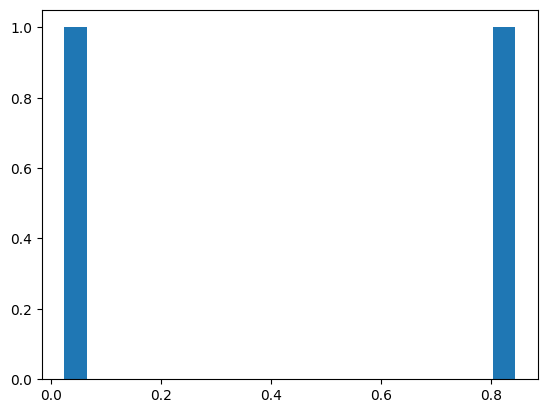

In [ ]:
# co_win_evaler.show_iou_distribution()

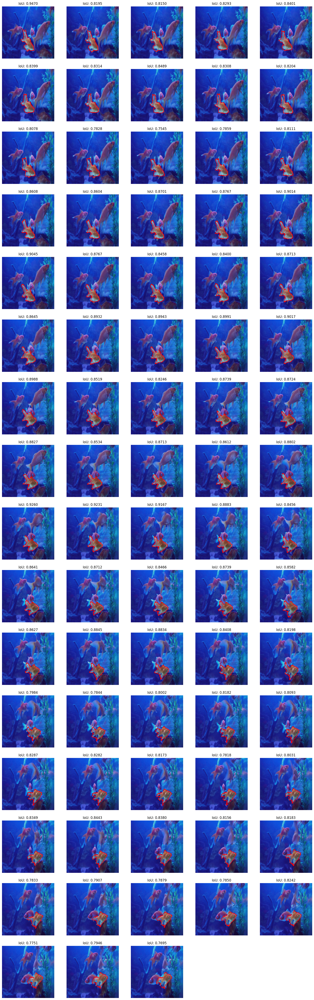

In [ ]:
# co_win_evaler.show_video_result(0, gt_rasterizer, img_per_line=5)

In [104]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [82]:
total_win_size = 40
small_win_size = 10
half_win_size = small_win_size // 2
sliding_win_num = (total_win_size - small_win_size) // half_win_size + 1
sliding_win_num, half_win_size

(7, 5)

In [106]:
val_video_set = DAVIS_Windows(val_point_set.raw_data_set, total_win_size)
co_win_evaler = CoWinEvaler(val_point_set.raw_data_set, gt_rasterizer, small_win_size)
# train_video_set = DAVIS_Windows(train_point_set.raw_data_set[66:], total_win_size)
train_video_set = DAVIS_Windows(train_point_set.raw_data_set, total_win_size)
train_video_loader = DataLoader(train_video_set, batch_size=1, shuffle=False)

In [105]:
loss_dict = {}
train_iou_dict = {}
eval_iou_dict = {}
epoch_num = 2
eval_interval = 2

In [ ]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for imgs, masks, points in tqdm(train_video_loader):
        fir_point = points[:, 0]
        cur_points = repeat(fir_point, "b p xy -> b f p xy", f=small_win_size)
        loss = 0
        iou = 0
        frame_num = len(imgs[0])
        sliding_win_num = (frame_num - small_win_size) // half_win_size + 1
        for i in range(0, sliding_win_num):
            cur_imgs = imgs[
                :, i * half_win_size : i * half_win_size + small_win_size
            ]
            cur_masks = masks[
                :, i * half_win_size : i * half_win_size + small_win_size
            ]
            optimizer.zero_grad()
            cur_imgs = cur_imgs.cuda()
            cur_masks = cur_masks.cuda()
            cur_points = cur_points.cuda()
            cur_pred_points = model(cur_imgs, cur_points)
            target_masks = cur_masks[:, 1:]
            tmp_loss, tmp_iou = video_loss(cur_pred_points, target_masks)
            tmp_loss.backward()
            optimizer.step()
            loss += tmp_loss.item()
            iou += tmp_iou.item()
            new_points = repeat(
                cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=half_win_size
            ).detach()
            old_points = cur_pred_points[:, -1, -half_win_size:].detach()
            cur_points = torch.cat([old_points, new_points], 1)
        if frame_num % half_win_size != 0:
            optimizer.zero_grad()
            cur_imgs = imgs[:, -small_win_size:]
            cur_imgs = cur_imgs.cuda()
            cur_masks = masks[:, -small_win_size:].cuda()
            left_len = frame_num - (sliding_win_num + 1) * half_win_size
            new_points = repeat(
                cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=left_len
            ).detach()
            old_point_num = small_win_size - left_len
            old_points = cur_pred_points[:, -1, -old_point_num:].detach()
            cur_points = torch.cat([old_points, new_points], 1)
            cur_points = cur_points.cuda()
            cur_pred_points = model(cur_imgs, cur_points)
            target_masks = cur_masks[:, 1:]
            tmp_loss, tmp_iou = video_loss(cur_pred_points, target_masks)
            tmp_loss.backward()
            optimizer.step()
            loss += tmp_loss.item()
            iou += tmp_iou.item()
        if frame_num % half_win_size == 0:
            loss /= sliding_win_num
            iou /= sliding_win_num
        else:
            loss /= sliding_win_num + 1
            iou /= sliding_win_num + 1
        total_loss += loss
        total_iou += iou
    total_loss /= len(train_video_loader)
    total_iou /= len(train_video_loader)
    print(f"Epoch {e}, Loss: {total_loss:.4f}, IoU: {total_iou:.4f}")
    loss_dict[e] = total_loss
    train_iou_dict[e] = total_iou
    if e % eval_interval == 0 or e == epoch_num - 1:
        eval_iou = co_win_evaler.eval_all_videos(model, use_tqdm=True)
        print(f"Eval IoU: {eval_iou:.4f}")
        eval_iou_dict[e] = eval_iou

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111/111 [06:22<00:00,  3.44s/it]


Epoch 0, Loss: 0.2802, IoU: 0.5682


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:52<00:00,  4.08s/it]


Eval IoU: 0.2109


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 111/111 [06:22<00:00,  3.45s/it]


Epoch 1, Loss: 0.1592, IoU: 0.7300


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 57/57 [03:56<00:00,  4.15s/it]

Eval IoU: 0.2255


In [25]:
model = Cotracker(32).cuda()
optimizer = Adam(model.parameters(), lr=1e-4)

Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


In [10]:
total_win_size = 40
small_win_size = 10
half_win_size = small_win_size // 2
sliding_win_num = (total_win_size - small_win_size) // half_win_size + 1
sliding_win_num, half_win_size

(7, 5)

In [23]:
tmp_raw_set = val_point_set.raw_data_set[22:23]
tmp_video_set = DAVIS_Windows(tmp_raw_set, total_win_size)
co_win_evaler = CoWinEvaler(tmp_raw_set, gt_rasterizer, small_win_size)
train_video_loader = DataLoader(tmp_video_set, batch_size=1, shuffle=False)
video_loss = VideoLoss(ras_loss, gt_rasterizer)

In [24]:
loss_dict = {}
train_iou_dict = {}
eval_iou_dict = {}
epoch_num = 100
eval_interval = 2

In [26]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for imgs, masks, points in tqdm(train_video_loader):
        fir_point = points[:, 0]
        cur_points = repeat(fir_point, "b p xy -> b f p xy", f=small_win_size)
        loss = 0
        iou = 0
        frame_num = len(imgs[0])
        sliding_win_num = (frame_num - small_win_size) // half_win_size + 1
        for i in range(0, sliding_win_num):
            cur_imgs = imgs[
                :, i * half_win_size : i * half_win_size + small_win_size
            ]
            cur_masks = masks[
                :, i * half_win_size : i * half_win_size + small_win_size
            ]
            optimizer.zero_grad()
            cur_imgs = cur_imgs.cuda()
            cur_masks = cur_masks.cuda()
            cur_points = cur_points.cuda()
            cur_pred_points = model(cur_imgs, cur_points)
            target_masks = cur_masks[:, 1:]
            tmp_loss, tmp_iou = video_loss(cur_pred_points, target_masks)
            tmp_loss.backward()
            optimizer.step()
            loss += tmp_loss.item()
            iou += tmp_iou.item()
            new_points = repeat(
                cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=half_win_size
            ).detach()
            old_points = cur_pred_points[:, -1, -half_win_size:].detach()
            cur_points = torch.cat([old_points, new_points], 1)
        if frame_num % half_win_size != 0:
            optimizer.zero_grad()
            cur_imgs = imgs[:, -small_win_size:]
            cur_imgs = cur_imgs.cuda()
            cur_masks = masks[:, -small_win_size:].cuda()
            left_len = frame_num - (sliding_win_num + 1) * half_win_size
            new_points = repeat(
                cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=left_len
            ).detach()
            old_point_num = small_win_size - left_len
            old_points = cur_pred_points[:, -1, -old_point_num:].detach()
            cur_points = torch.cat([old_points, new_points], 1)
            cur_points = cur_points.cuda()
            cur_pred_points = model(cur_imgs, cur_points)
            target_masks = cur_masks[:, 1:]
            tmp_loss, tmp_iou = video_loss(cur_pred_points, target_masks)
            tmp_loss.backward()
            optimizer.step()
            loss += tmp_loss.item()
            iou += tmp_iou.item()
        if frame_num % half_win_size == 0:
            loss /= sliding_win_num
            iou /= sliding_win_num
        else:
            loss /= sliding_win_num + 1
            iou /= sliding_win_num + 1
        total_loss += loss
        total_iou += iou
    total_loss /= len(train_video_loader)
    total_iou /= len(train_video_loader)
    print(f"Epoch {e}, Loss: {total_loss:.4f}, IoU: {total_iou:.4f}")
    loss_dict[e] = total_loss
    train_iou_dict[e] = total_iou
    if e % eval_interval == 0 or e == epoch_num - 1:
        eval_iou = co_win_evaler.eval_all_videos(model, use_tqdm=True)
        print(f"Eval IoU: {eval_iou:.4f}")
        eval_iou_dict[e] = eval_iou

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.49s/it]


Epoch 0, Loss: 0.5139, IoU: 0.3147


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.10s/it]


Eval IoU: 0.2569


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.44s/it]


Epoch 1, Loss: 0.5913, IoU: 0.2790


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 2, Loss: 0.3930, IoU: 0.4419


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.12s/it]


Eval IoU: 0.1737


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 3, Loss: 0.7568, IoU: 0.1265


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 4, Loss: 0.3521, IoU: 0.4518


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.13s/it]


Eval IoU: 0.1557


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 5, Loss: 0.5456, IoU: 0.2919


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 6, Loss: 0.3043, IoU: 0.4981


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.0698


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 7, Loss: 0.7203, IoU: 0.1329


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 8, Loss: 0.4219, IoU: 0.4030


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.16s/it]


Eval IoU: 0.2624


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 9, Loss: 0.5845, IoU: 0.2655


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 10, Loss: 0.4229, IoU: 0.3693


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.1939


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 11, Loss: 0.6960, IoU: 0.1713


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 12, Loss: 0.3110, IoU: 0.5152


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.11s/it]


Eval IoU: 0.3892


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 13, Loss: 0.4425, IoU: 0.3957


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 14, Loss: 0.3299, IoU: 0.4894


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.13s/it]


Eval IoU: 0.5850


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.44s/it]


Epoch 15, Loss: 0.2514, IoU: 0.5851


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 16, Loss: 0.2624, IoU: 0.5967


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.4956


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 17, Loss: 0.2290, IoU: 0.6029


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 18, Loss: 0.1980, IoU: 0.6592


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.5288


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 19, Loss: 0.2687, IoU: 0.5837


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 20, Loss: 0.1925, IoU: 0.6811


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.4127


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 21, Loss: 0.2000, IoU: 0.6522


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 22, Loss: 0.2000, IoU: 0.6619


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.4823


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 23, Loss: 0.2090, IoU: 0.6575


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 24, Loss: 0.1826, IoU: 0.6807


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.16s/it]


Eval IoU: 0.6415


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 25, Loss: 0.1862, IoU: 0.6875


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 26, Loss: 0.2241, IoU: 0.6419


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7175


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 27, Loss: 0.1785, IoU: 0.6875


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 28, Loss: 0.1545, IoU: 0.7360


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.6484


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 29, Loss: 0.1956, IoU: 0.6777


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 30, Loss: 0.1437, IoU: 0.7500


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.6877


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.44s/it]


Epoch 31, Loss: 0.1556, IoU: 0.7323


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 32, Loss: 0.1588, IoU: 0.7361


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.12s/it]


Eval IoU: 0.7167


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 33, Loss: 0.1466, IoU: 0.7475


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 34, Loss: 0.1372, IoU: 0.7568


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.16s/it]


Eval IoU: 0.7162


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 35, Loss: 0.1406, IoU: 0.7625


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 36, Loss: 0.1514, IoU: 0.7413


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7178


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 37, Loss: 0.1297, IoU: 0.7697


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 38, Loss: 0.1271, IoU: 0.7786


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7014


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 39, Loss: 0.1897, IoU: 0.6867


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 40, Loss: 0.1458, IoU: 0.7465


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.6677


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 41, Loss: 0.1726, IoU: 0.7080


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 42, Loss: 0.1427, IoU: 0.7499


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.06s/it]


Eval IoU: 0.7061


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 43, Loss: 0.1636, IoU: 0.7177


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 44, Loss: 0.1657, IoU: 0.7148


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.08s/it]


Eval IoU: 0.7333


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 45, Loss: 0.1533, IoU: 0.7393


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 46, Loss: 0.1566, IoU: 0.7254


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.10s/it]


Eval IoU: 0.7215


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 47, Loss: 0.1524, IoU: 0.7456


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 48, Loss: 0.1472, IoU: 0.7417


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.10s/it]


Eval IoU: 0.7262


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 49, Loss: 0.1357, IoU: 0.7589


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 50, Loss: 0.1225, IoU: 0.7840


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.06s/it]


Eval IoU: 0.7377


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 51, Loss: 0.1262, IoU: 0.7822


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 52, Loss: 0.1195, IoU: 0.7974


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.07s/it]


Eval IoU: 0.6495


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 53, Loss: 0.1387, IoU: 0.7580


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 54, Loss: 0.1431, IoU: 0.7469


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.11s/it]


Eval IoU: 0.6592


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 55, Loss: 0.1256, IoU: 0.7824


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 56, Loss: 0.1330, IoU: 0.7680


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.06s/it]


Eval IoU: 0.7343


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 57, Loss: 0.1183, IoU: 0.7880


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 58, Loss: 0.1415, IoU: 0.7573


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.05s/it]


Eval IoU: 0.7000


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 59, Loss: 0.1361, IoU: 0.7641


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 60, Loss: 0.1383, IoU: 0.7681


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.05s/it]


Eval IoU: 0.7336


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 61, Loss: 0.1397, IoU: 0.7561


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 62, Loss: 0.1403, IoU: 0.7584


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.06s/it]


Eval IoU: 0.7330


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 63, Loss: 0.1223, IoU: 0.7889


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 64, Loss: 0.1234, IoU: 0.7791


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.07s/it]


Eval IoU: 0.7609


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.44s/it]


Epoch 65, Loss: 0.1419, IoU: 0.7631


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 66, Loss: 0.1215, IoU: 0.7910


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.08s/it]


Eval IoU: 0.7712


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.42s/it]


Epoch 67, Loss: 0.1354, IoU: 0.7638


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 68, Loss: 0.1124, IoU: 0.8018


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.06s/it]


Eval IoU: 0.7511


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.43s/it]


Epoch 69, Loss: 0.1439, IoU: 0.7531


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.44s/it]


Epoch 70, Loss: 0.1351, IoU: 0.7667


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.7337


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 71, Loss: 0.1408, IoU: 0.7521


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 72, Loss: 0.1268, IoU: 0.7827


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.4973


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 73, Loss: 0.1391, IoU: 0.7516


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 74, Loss: 0.1415, IoU: 0.7559


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7416


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.48s/it]


Epoch 75, Loss: 0.1179, IoU: 0.7934


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.48s/it]


Epoch 76, Loss: 0.1264, IoU: 0.7786


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.16s/it]


Eval IoU: 0.7216


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 77, Loss: 0.1150, IoU: 0.7968


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 78, Loss: 0.1284, IoU: 0.7792


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.15s/it]


Eval IoU: 0.7461


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 79, Loss: 0.1153, IoU: 0.7981


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 80, Loss: 0.1313, IoU: 0.7717


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7345


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 81, Loss: 0.1313, IoU: 0.7728


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 82, Loss: 0.1186, IoU: 0.7942


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7625


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 83, Loss: 0.1216, IoU: 0.7873


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 84, Loss: 0.1185, IoU: 0.7979


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7672


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 85, Loss: 0.1260, IoU: 0.7838


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.48s/it]


Epoch 86, Loss: 0.1194, IoU: 0.7906


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.16s/it]


Eval IoU: 0.7577


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 87, Loss: 0.1168, IoU: 0.7944


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 88, Loss: 0.1214, IoU: 0.7900


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7774


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 89, Loss: 0.1061, IoU: 0.8149


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 90, Loss: 0.0952, IoU: 0.8316


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7656


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 91, Loss: 0.1149, IoU: 0.8033


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 92, Loss: 0.1156, IoU: 0.7983


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7293


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 93, Loss: 0.1597, IoU: 0.7285


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 94, Loss: 0.1280, IoU: 0.7715


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7321


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 95, Loss: 0.1177, IoU: 0.7978


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 96, Loss: 0.1218, IoU: 0.7854


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.17s/it]


Eval IoU: 0.7753


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.45s/it]


Epoch 97, Loss: 0.1142, IoU: 0.7964


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.46s/it]


Epoch 98, Loss: 0.1024, IoU: 0.8222


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]


Eval IoU: 0.7763


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.47s/it]


Epoch 99, Loss: 0.1115, IoU: 0.8029


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.14s/it]

Eval IoU: 0.7728


In [56]:
gc.collect()
torch.cuda.empty_cache()

In [6]:
torch.cuda.memory_allocated(0) / 1024**3

0.0

In [148]:
for i in range(len(val_point_set.raw_data_set)):
    if len(val_point_set.raw_data_set[i]) < 30:
        print(i, len(val_point_set.raw_data_set[i]))

In [183]:
val_video_set = DAVIS_Windows(val_point_set.raw_data_set[22:23], 30 + 1)
val_video_loader = DataLoader(val_video_set, batch_size=1, shuffle=True)
imgs, masks, points = next(iter(val_video_loader))
gt_rasterizer = SoftPolygon(1, "hard_mask").cuda()
ras_loss = RasLoss().cuda()
video_loss = VideoLoss(ras_loss, gt_rasterizer)
print(imgs.shape, masks.shape, points.shape)

torch.Size([1, 31, 3, 224, 224]) torch.Size([1, 31, 224, 224]) torch.Size([1, 31, 32, 2])


In [152]:
class CotrackerWin(nn.Module):
    def __init__(
        self,
        point_num: int,
        refine_iter: int = 3,
        freeze_featup: bool = True,
        d_model: int = 256,
        n_heads: int = 8,
        n_points: int = 8,
        d_ffn: int = 1024,
        n_layers: int = 1,
        offset_ratio: float = 0.35,
    ):
        super(CotrackerWin, self).__init__()
        self.refine_iter = refine_iter
        self.featup = torch.hub.load(
            "mhamilton723/FeatUp",
            "dino16",
            use_norm=True,
        )
        if freeze_featup:
            for param in self.featup.parameters():
                param.requires_grad = False
        d_featup = 384
        if d_featup != d_model:
            self.featup_fc = nn.Linear(d_featup, d_model)
        else:
            self.featup_fc = nn.Identity()
        self.medium_level_size = [14, 28, 56, 112]
        n_levels = len(self.medium_level_size) + 1
        self.offset_ratio = offset_ratio
        self.pos_2d = IMGPositionEmbeddingSine(d_model)
        self.pos_1d = PositionalEncoding(d_model)
        self.level_pos = nn.Embedding(n_levels, d_model)
        nn.init.xavier_uniform_(self.level_pos.weight)

        self.query_embed = nn.Embedding(point_num, d_model)
        self.fir_query_embed = nn.Embedding(point_num, d_model)
        nn.init.xavier_uniform_(self.query_embed.weight)
        dec_layer = DeformableTransformerDecoderLayer(
            d_model=d_model,
            d_ffn=d_ffn,
            n_levels=n_levels,
            n_heads=n_heads,
            n_points=n_points,
        )
        self.def_dec_layernorm = nn.LayerNorm(d_model)
        self.def_decoder = DeformableTransformerDecoder(
            decoder_layer=dec_layer,
            num_layers=n_layers,
        )
        self.fir_layernorm = nn.LayerNorm(d_model)
        self.fir_encoder = nn.TransformerEncoder(
            encoder_layer=nn.TransformerEncoderLayer(
                d_model,
                n_heads,
                d_ffn,
                batch_first=True,
            ),
            num_layers=n_layers,
        )
        self.other_layernorm = nn.LayerNorm(d_model)
        self.other_decoder = nn.TransformerDecoder(
            decoder_layer=nn.TransformerDecoderLayer(
                d_model,
                n_heads,
                d_ffn,
                batch_first=True,
            ),
            num_layers=n_layers,
        )
        self.delta_xy_fc = MLP(d_model, d_model, 2, 3)
        self.delta_query_fc = MLP(d_model, d_model, d_model, 3)

    def _get_img_scrs(self, img: torch.Tensor, layernorm: nn.LayerNorm):
        b, c, h, w = img.shape
        feats = self.featup(img)
        feats = rearrange(feats, "b c h w -> b (h w) c")
        feats = self.featup_fc(feats)
        feats = rearrange(feats, "b (h w) c -> b c h w", h=h, w=w)
        srcs = []
        padding_masks = []
        pos_embeds = []
        for low_res in self.medium_level_size:
            srcs.append(
                F.interpolate(
                    feats,
                    size=(low_res, low_res),
                    mode="bilinear",
                ),
            )
        srcs.append(feats)
        for src in srcs:
            padding_masks.append(torch.zeros_like(src[:, 0:1, :, :]).squeeze(1).bool())
            pos_embeds.append(self.pos_2d(src, padding_masks[-1]))
        src_flatten = []
        spatial_shapes = []
        pos_embed_flatten = []

        for lvl, (src, pos) in enumerate(zip(srcs, pos_embeds)):
            src_flatten.append(
                rearrange(src, "b c h w -> b (h w) c"),
            )
            spatial_shapes.append(src.shape[-2:])
            pos = rearrange(pos, "b c h w -> b (h w) c")
            pos = self.level_pos.weight[lvl].view(1, 1, -1) + pos
            pos_embed_flatten.append(pos)

        level_start_index = torch.cat(
            (
                torch.tensor([0]),
                torch.cumsum(
                    torch.tensor([x.shape[1] for x in src_flatten]),
                    0,
                )[:-1],
            )
        ).cuda()
        src_flatten = torch.cat(src_flatten, 1).cuda()
        pos_embed_flatten = torch.cat(pos_embed_flatten, 1).cuda()
        valid_ratios = torch.stack(
            [get_valid_ratio(mask) for mask in padding_masks],
            1,
        ).cuda()
        spatial_shapes = torch.as_tensor(
            spatial_shapes,
            dtype=torch.long,
            device=src_flatten.device,
        )
        src_flatten = layernorm(src_flatten)

        return (
            src_flatten,
            spatial_shapes,
            level_start_index,
            valid_ratios,
            pos_embed_flatten,
        )

    def forward(
        self,
        fir_img: torch.Tensor,
        fir_points: torch.Tensor,
        imgs: torch.Tensor,
        points: torch.Tensor,
        queries: torch.Tensor = None,
    ):
        batch_size, frame_num, _, img_h, img_w = imgs.shape
        _, _, point_num, _ = points.shape

        fir_points = fir_points / 224.0
        points = points / 224.0

        (
            fir_src_flatten,
            fir_spatial_shapes,
            fir_level_start_index,
            fir_valid_ratios,
            fir_pos_embed_flatten,
        ) = self._get_img_scrs(fir_img, self.def_dec_layernorm)
        fir_src_flatten += fir_pos_embed_flatten
        fir_query_embed = repeat(
            self.fir_query_embed.weight, "p d -> b p d", b=batch_size
        )
        fir_point_feats, _ = self.def_decoder(
            fir_query_embed,
            fir_points,
            fir_src_flatten,
            fir_spatial_shapes,
            fir_level_start_index,
            fir_valid_ratios,
        )
        fir_point_feats = self.fir_layernorm(fir_point_feats)
        fir_query = self.pos_1d(fir_point_feats)
        fir_memory = self.fir_encoder(fir_query)

        imgs = rearrange(imgs, "b f c h w -> (b f) c h w")
        points = rearrange(points, "b f p d -> (b f) p d")
        (
            src_flatten,
            spatial_shapes,
            level_start_index,
            valid_ratios,
            pos_embed_flatten,
        ) = self._get_img_scrs(imgs, self.def_dec_layernorm)
        src_flatten += pos_embed_flatten
        if queries is None:
            queries = repeat(
                self.query_embed.weight, "p d -> b p d", b=batch_size * frame_num
            )
        else:
            queries = rearrange(queries, "b f p d -> (b f) p d", f=frame_num)

        output_coords = []
        for i in range(self.refine_iter):
            point_feats, _ = self.def_decoder(
                queries,
                points,
                src_flatten,
                spatial_shapes,
                level_start_index,
                valid_ratios,
            )
            point_queries = rearrange(point_feats, "(b f)p d -> b (f p) d", f=frame_num)
            point_queries = self.other_layernorm(point_queries)
            point_queries = self.pos_1d(point_queries)
            point_queries = self.other_decoder(
                tgt=point_queries,
                memory=fir_memory,
            )
            point_queries = rearrange(
                point_queries, "b (f p) d -> (b f) p d", f=frame_num
            )
            delta_xy = self.delta_xy_fc(point_queries)
            delta_xy = (delta_xy.sigmoid() - 0.5) * 2 * self.offset_ratio
            points = points + delta_xy
            result = rearrange(
                points, "(b f) p d -> b f p d", b=batch_size, f=frame_num
            )
            result = result * 224.0
            output_coords.append(result)
            delta_query = self.delta_query_fc(point_feats)
            queries = queries + delta_query
        output_coords = torch.stack(output_coords, 1)
        queries = rearrange(queries, "(b f) p d -> b f p d", b=batch_size)
        return output_coords, queries


model = CotrackerWin(32).cuda()
window_size = 10
with torch.no_grad():
    output_coords, queries = model(
        imgs[:, 0].cuda(),
        points[:, 0].cuda(),
        imgs[:, 1 : window_size + 1].cuda(),
        points[:, 1 : window_size + 1].cuda(),
        queries=None,
    )
    print(output_coords.shape, queries.shape)
    output_coords, queries = model(
        imgs[:, 0].cuda(),
        points[:, 0].cuda(),
        imgs[:, 1 : window_size + 1].cuda(),
        points[:, 1 : window_size + 1].cuda(),
        queries=queries,
    )
    print(output_coords.shape, queries.shape)


Using cache found in /zhome/32/f/202284/.cache/torch/hub/mhamilton723_FeatUp_main
Using cache found in /zhome/32/f/202284/.cache/torch/hub/facebookresearch_dino_main


torch.Size([1, 3, 10, 32, 2]) torch.Size([1, 10, 32, 256])
torch.Size([1, 3, 10, 32, 2]) torch.Size([1, 10, 32, 256])


In [153]:
total_win_size = 30
small_win_size = 10
half_win_size = small_win_size // 2
sliding_win_num = (total_win_size - small_win_size) // half_win_size + 1
sliding_win_num, half_win_size

(5, 5)

In [154]:
optimizer = Adam(model.parameters(), lr=1e-4)

In [155]:
epoch_num = 200

In [156]:
half_win_size, small_win_size

(5, 10)

In [176]:
for e in range(epoch_num):
    total_loss = 0
    total_iou = 0
    for imgs, masks, points in val_video_loader:
        fir_point = points[:, 0]
        fir_img = imgs[:, 0]
        imgs = imgs[:, 1:]
        masks = masks[:, 1:]
        frame_num = len(imgs[0])
        sliding_win_num = (frame_num - small_win_size) // half_win_size + 1
        cur_points = repeat(fir_point, "b p xy -> b f p xy", f=small_win_size)
        queries = None
        pred_results = None
        optimizer.zero_grad()
        for i in range(0, sliding_win_num):
            cur_imgs = imgs[:, i * half_win_size : i * half_win_size + small_win_size]
            cur_imgs = cur_imgs.cuda()
            cur_points = cur_points.cuda()
            cur_pred_points, queries = model(
                fir_img.cuda(),
                fir_point.cuda(),
                cur_imgs.cuda(),
                cur_points,
                queries=queries,
            )
            if pred_results is None:
                pred_results = cur_pred_points
            else:
                new_pred_points = cur_pred_points[:, :, -half_win_size:]
                pred_results = torch.cat([pred_results, new_pred_points], 2)
            old_points = cur_pred_points[:, -1, -half_win_size:]
            new_points = repeat(
                cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=half_win_size
            )
            cur_points = torch.cat([old_points, new_points], 1)
        loss, iou = video_loss(pred_results, masks.cuda())
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        total_iou += iou.item()
    total_loss /= len(val_video_loader)
    total_iou /= len(val_video_loader)
    print(f"Epoch {e}, Loss: {total_loss:.4f}, IoU: {total_iou:.4f}")

                
            

OutOfMemoryError: CUDA out of memory. Tried to allocate 2.93 GiB. GPU 0 has a total capacity of 31.73 GiB of which 1.96 GiB is free. Process 2002730 has 492.00 MiB memory in use. Process 2005714 has 492.00 MiB memory in use. Process 2437555 has 1.41 GiB memory in use. Process 2438823 has 524.00 MiB memory in use. Including non-PyTorch memory, this process has 26.44 GiB memory in use. Process 2483049 has 456.00 MiB memory in use. Of the allocated memory 22.09 GiB is allocated by PyTorch, and 3.98 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

  0%|                                                                                                                                                        | 0/1 [00:00<?, ?it/s]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.22s/it]

torch.Size([78, 32, 2])


0.6688240170478821

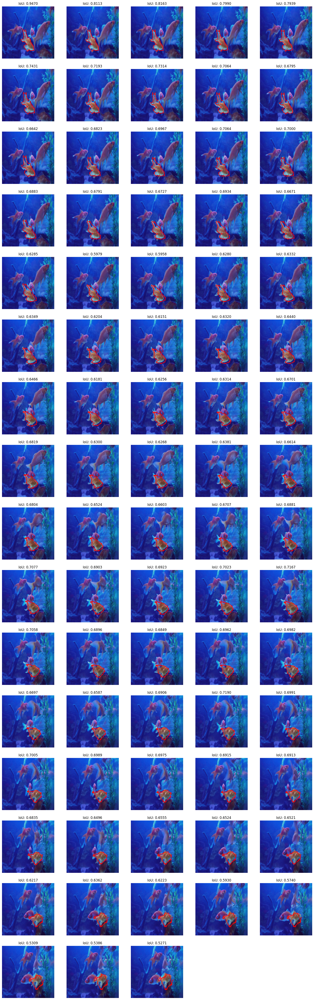

In [184]:
class CoEvaler_Windows:
    def __init__(
        self,
        raw_set: list[list[tuple[torch.Tensor, torch.Tensor]]],
        gt_rasterizer: SoftPolygon,
        frame_num: int = 10,
    ) -> None:
        self.raw_set = raw_set
        self.gt_rasterizer = gt_rasterizer
        self.frame_num = frame_num
        self.total_pred_results = []

    def eval_one_video(self, video_idx: int, model: CotrackerWin):
        video_data = self.raw_set[video_idx]
        video_len = len(video_data) - 1
        img_list = []
        mask_list = []
        point_list = []
        for frame_idx in range(video_len + 1):
            img, mask, point = video_data[frame_idx]
            img_list.append(img)
            mask_list.append(mask)
            point_list.append(point)
        total_imgs = torch.stack(img_list, 0).unsqueeze(0)
        total_masks = torch.stack(mask_list, 0).unsqueeze(0)
        total_points = torch.stack(point_list, 0).unsqueeze(0)
        fir_point = total_points[:, 0]
        half_win_size = self.frame_num // 2
        sliding_win_num = (video_len - self.frame_num) // half_win_size + 1
        fir_img = total_imgs[:, 0]
        total_imgs = total_imgs[:, 1:]
        cur_points = repeat(fir_point, "b p xy -> b f p xy", f=self.frame_num)
        pred_results = None
        queries = None
        with torch.no_grad():
            model.eval()
            for i in range(0, sliding_win_num):
                cur_imgs = total_imgs[
                    :, i * half_win_size : i * half_win_size + self.frame_num
                ]
                cur_imgs = cur_imgs.cuda()
                cur_points = cur_points.cuda()
                cur_pred_points, queries = model(
                    fir_img.cuda(),
                    fir_point.cuda(),
                    cur_imgs.cuda(),
                    cur_points,
                    queries=queries,
                )
                if pred_results is None:
                    pred_results = cur_pred_points
                else:
                    new_pred_points = cur_pred_points[:, :, -half_win_size:]
                    pred_results = torch.cat([pred_results, new_pred_points], 2)
                old_points = cur_pred_points[:, -1, -half_win_size:]
                new_points = repeat(
                    cur_pred_points[:, -1, -1], "b p xy -> b f p xy", f=half_win_size
                )
                cur_points = torch.cat([old_points, new_points], 1)
        if video_len % half_win_size != 0:
            cur_imgs = total_imgs[:, -self.frame_num :]
            cur_imgs = cur_imgs.cuda()
            left_len = video_len - (sliding_win_num + 1) * half_win_size
            new_points = repeat(
                pred_results[:, -1, -1], "b p xy -> b f p xy", f=left_len
            )
            old_point_num = self.frame_num - left_len
            old_points = pred_results[:, -1, -old_point_num:]
            cur_points = torch.cat([old_points, new_points], 1)
            cur_points = cur_points.cuda()
            cur_pred_points, queries = model(
                fir_img.cuda(),
                fir_point.cuda(),
                cur_imgs.cuda(),
                cur_points,
                queries=queries,
            )
            left_pred_points = cur_pred_points[:, :, -left_len:]
            pred_results = torch.cat([pred_results, left_pred_points], 2)
        total_pred_results = pred_results[:, 0]
        total_pred_results = total_pred_results.squeeze(0)
        target_masks = total_masks[:, 1:]
        target_masks = target_masks.squeeze(0)
        total_iou = get_batch_average_bou_iou(
            total_pred_results.cuda(),
            target_masks.cuda(),
            self.gt_rasterizer,
        ).item()
        total_pred_results = total_pred_results.detach().cpu()
        total_pred_results = torch.cat([fir_point.cpu(), total_pred_results], 0)
        print(total_pred_results.shape)
        return total_iou, total_pred_results.detach().cpu()
    
    def compute_avg_iou(self):
        iou_list = [iou for iou, _ in self.total_pred_results]
        return sum(iou_list) / len(iou_list)
    
    def eval_all_videos(self, model: CotrackerWin, use_tqdm: bool = False):
        self.total_pred_results = []
        video_num = len(self.raw_set)
        if use_tqdm:
            video_iter = tqdm(range(video_num))
        else:
            video_iter = range(video_num)
        for video_idx in video_iter:
            iou, pred_results = self.eval_one_video(video_idx, model)
            self.total_pred_results.append((iou, pred_results))
        return self.compute_avg_iou()

    def show_iou_distribution(self):
        iou_list = [iou for iou, _ in self.total_pred_results]
        plt.hist(iou_list, bins=20)
        plt.show()
    
    def show_video_result(
        self,
        video_idx: int,
        img_per_line=5,
        mask_alpha=0.2,
    ):
        video_data = self.raw_set[video_idx]
        frame_num = len(video_data)
        line_num = (frame_num - 1) // img_per_line + 1
        total_pred_points = self.total_pred_results[video_idx][1]
        plt.figure(figsize=(img_per_line * 4, line_num * 4))
        for i, pred_point in enumerate(total_pred_points):
            plt.subplot(line_num, img_per_line, i + 1)
            plt.axis("off")
            img, mask, point = video_data[i]
            plt.imshow(normalize(img).permute(1, 2, 0))
            iou = get_batch_average_bou_iou(pred_point.unsqueeze(0).cuda(), mask.unsqueeze(0).cuda(), self.gt_rasterizer).item()
            plt.title(f"IoU: {iou:.4f}")
            plt.scatter(pred_point[:, 0], pred_point[:, 1], c="r", s=5)
            plt.plot(pred_point[:, 0], pred_point[:, 1], c="r")
            plt.imshow(mask, alpha=mask_alpha)

co_win_evaler = CoEvaler_Windows(val_point_set.raw_data_set[22:23], gt_rasterizer, 10)
co_win_evaler.eval_all_videos(model, use_tqdm=True)
co_win_evaler.show_video_result(0, img_per_line=5)
co_win_evaler.compute_avg_iou()

In [175]:
len(co_win_evaler.total_pred_results[0][1])

77

In [181]:
if "fir_imgs" in locals():
    del fir_imgs
if "fir_masks" in locals():
    del fir_masks
if "fir_points" in locals():
    del fir_points
if "fir_pred_points" in locals():
    del fir_pred_points
if "cur_imgs" in locals():
    del cur_imgs
if "cur_masks" in locals():
    del cur_masks
if "cur_points" in locals():
    del cur_points
if "cur_pred_points" in locals():
    del cur_pred_points
if "new_points" in locals():
    del new_points
if "old_points" in locals():
    del old_points
if "new_pred_points" in locals():
    del new_pred_points
if "total_pred_points" in locals():
    del total_pred_points
# if "model" in locals():
#     del model
if "optimizer" in locals():
    del optimizer
if "imgs" in locals():
    del imgs
if "masks" in locals():
    del masks
if "points" in locals():
    del points
if "iou" in locals():
    del iou
if "loss" in locals():
    del loss
if "tmp_loss" in locals():
    del tmp_loss
if "tmp_iou" in locals():
    del tmp_iou
if "target_masks" in locals():
    del target_masks
if "fir_point" in locals():
    del fir_point
if "fir_img" in locals():
    del fir_img
if "output_coords" in locals():
    del output_coords
if "queries" in locals():
    del queries
if "pred_results" in locals():
    del pred_results
if "video_loss" in locals():
    del video_loss
if "ras_loss" in locals():
    del ras_loss
if "gt_rasterizer" in locals():
    del gt_rasterizer

# if "video_loss" in locals():
#     del video_loss
# if "ras_loss" in locals():
#     del ras_loss
# if "gt_rasterizer" in locals():
#     del gt_rasterizer
# if "val_video_loader" in locals():
#     del val_video_loader
# if "val_video_set" in locals():
#     del val_video_set

gc.collect()
torch.cuda.empty_cache()
print(torch.cuda.memory_allocated(0) / 1024**3)
print(torch.cuda.memory_reserved(0) / 1024**3)
print(torch.cuda.max_memory_reserved(0) / 1024**3)

4.935007095336914
20.109375
29.28125


In [179]:
gc.collect()
torch.cuda.empty_cache()